# Transfer Learning for Computer Vision Tutorial
**Extended from [code](https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html) by [Sasank Chilamkurthy](https://chsasank.github.io).**  
License: BSD.

In this tutorial, you will learn how to train a convolutional neural network for
image classification using transfer learning. You can read more about the transfer
learning at the [CS231N notes](https://cs231n.github.io/transfer-learning/).

Quoting these notes:

    In practice, very few people train an entire Convolutional Network
    from scratch (with random initialization), because it is relatively
    rare to have a dataset of sufficient size. Instead, it is common to
    pretrain a ConvNet on a very large dataset (e.g. ImageNet, which
    contains 1.2 million images with 1000 categories), and then use the
    ConvNet either as an initialization or a fixed feature extractor for
    the task of interest.

These two major transfer learning scenarios look as follows:

-  **Finetuning the convnet**: Instead of random initializaion, we
   initialize the network with a pretrained network, like the one that is
   trained on imagenet 1000 dataset. Rest of the training looks as
   usual.
-  **ConvNet as fixed feature extractor**: Here, we will freeze the weights
   for all of the network except that of the final fully connected
   layer. This last fully connected layer is replaced with a new one
   with random weights and only this layer is trained.




### Running notes
If you are running this in Google Colab, be sure to change the runtime to GPU by clicking `Runtime > Change runtime type` and selecting "GPU" from the dropdown menu.

### Import relevant packages

In [1]:
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [3]:
from __future__ import print_function, division

import numpy as np
import matplotlib.pyplot as plt
import time
import os
import copy
plt.ion()   # interactive mode

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler

import torchvision
from torchvision import datasets, models, transforms
from sklearn.metrics import accuracy_score


## Load Data

We will use `torchvision` and `torch.utils.data` packages for loading the
data.

The problem we're going to solve today is to train a model to classify
present and future **Israeli politicians**.  
We have about ~100 training images for each of our 9 politicians, automatically scraped from the first page of the Google Images Search without manual review.  
Usually, this is a very small dataset to generalize upon, if trained from scratch (or is it? We'll soon test this ourselves!). Since we are using transfer learning, we should be able to generalize reasonably well.

In [5]:
# Create a folder for our data
# The ! prefix runs this as a shell command
!mkdir data
!mkdir data/israeli_politicians

In [6]:
# Download our dataset and extract it
import requests
from zipfile import ZipFile

url = 'https://github.com/omriallouche/ydata_deep_learning_2021/blob/main/data/israeli_politicians.zip?raw=true'
r = requests.get(url, allow_redirects=True)
open('./data/israeli_politicians.zip', 'wb').write(r.content)

with ZipFile('./data/israeli_politicians.zip', 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall(path='./data/israeli_politicians/')

In [7]:
# On Linux machines, the following simpler code can be used instead
# !wget https://github.com/omriallouche/ydata_deep_learning_2021/blob/main/data/israeli_politicians.zip?raw=true
# !unzip israeli_politicians.zip -d data/israeli_politicians/

### Dataset Review
At this stage, we suggest that you review your given data and get to know it better.  
Try to look for things that might interfere with its ability to learn and generalize.

### Datasets definition
PyTorch uses DataLoaders to define datasets. We'll create 2 data loaders, `train` and `val` (for validation).  
Our dataset was already split into different folders for these - as you can see under the "Files" menu on the left of the Colab.

 PyTorch provides two data primitives: torch.utils.data.DataLoader and torch.utils.data.Dataset that allow you to use pre-loaded datasets as well as your own data. Dataset stores the samples and their corresponding labels, and DataLoader wraps an iterable around the Dataset to enable easy access to the samples https://pytorch.org/tutorials/beginner/basics/data_tutorial.html
 

In [8]:
# Define transformations that resize the images to 256x256, and normalize them. 
# The means and standard deviations of each channel are the values used for normalization in ImageNet
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

In [9]:
data_dir = r'./data/israeli_politicians/'

# Create a dictionary of train and val datasets from images in folders
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}

In [10]:
image_datasets

{'train': Dataset ImageFolder
     Number of datapoints: 929
     Root location: ./data/israeli_politicians/train
     StandardTransform
 Transform: Compose(
                Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=warn)
                ToTensor()
                Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
            ),
 'val': Dataset ImageFolder
     Number of datapoints: 234
     Root location: ./data/israeli_politicians/val
     StandardTransform
 Transform: Compose(
                Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=warn)
                ToTensor()
                Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
            )}

A data loader wraps an iterable around the Dataset to enable easy access to the samples. It combines a dataset and a sampler.

In [11]:
dataloaders = {
    'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=16,
                                             shuffle=True, num_workers=4),
    'val': torch.utils.data.DataLoader(image_datasets['val'], batch_size=16,
                                          shuffle=False, num_workers=4)
  }

In [12]:
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
print('dataset_sizes: ', dataset_sizes)

class_names = image_datasets['train'].classes
print('class_names:', class_names)

dataset_sizes:  {'train': 929, 'val': 234}
class_names: ['ayelet_shaked', 'benjamin_netanyahu', 'benny_gantz', 'danny_danon', 'gideon_saar', 'kostya_kilimnik', 'naftali_bennett', 'ofir_akunis', 'yair_lapid']


In [13]:
# Check for the availability of a GPU, and use CPU otherwise
# If you are using Google Colab, be sure to change your runtime environment to GPU first.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

### Datasets and Dataloaders
Let's examine the dataloaders and datasets and learn more about their attributes and functions.  

In [14]:
train_dataloader = dataloaders['train']

In Colab or Jupyter notebook, if we type  `train_dataloader.` and wait, we'd see a drop-down with the object attributes and functions.  

`train_dataloader.dataset.samples` contains the filenames + true labels (0 to 8 for our 9 classes).  
`train_dataloader.dataset.classes` contains the class names in order.  
`train_dataloader.dataset.class_to_idx` contains a map from a class name to the integer that represents it.

In [15]:
train_dataloader.dataset.classes

['ayelet_shaked',
 'benjamin_netanyahu',
 'benny_gantz',
 'danny_danon',
 'gideon_saar',
 'kostya_kilimnik',
 'naftali_bennett',
 'ofir_akunis',
 'yair_lapid']

In [16]:
train_dataloader.dataset.class_to_idx

{'ayelet_shaked': 0,
 'benjamin_netanyahu': 1,
 'benny_gantz': 2,
 'danny_danon': 3,
 'gideon_saar': 4,
 'kostya_kilimnik': 5,
 'naftali_bennett': 6,
 'ofir_akunis': 7,
 'yair_lapid': 8}

### Visualize a few images

Let's visualize a few training images so as to understand the data
augmentations.



In [17]:
# A helper function to show an image from a tensor. We need to restore it to the original dynamic range before normalization
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array(means)
    std = np.array(stds)
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    fig = plt.figure(figsize=(5,3), dpi=300)
    #fig = plt.figure(figsize=(2,1), dpi=300) # try to make the pics smaller
    plt.imshow(inp)
    if title is not None:
       plt.title(title, fontsize=5)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [18]:
# Get a batch of training data - the data loader is a generator
inputs, classes = next(iter(dataloaders['train']))

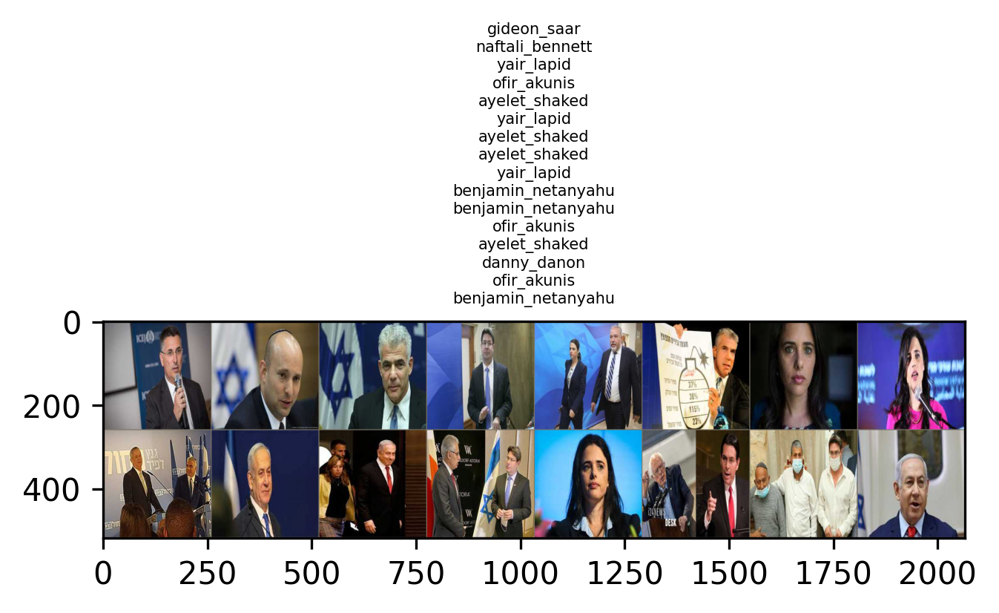

In [19]:
inputs, classes = next(iter(dataloaders['train']))
# Make a grid from batch
out = torchvision.utils.make_grid(inputs, nrow=8)

imshow(out, title='\n'.join([class_names[x] for x in classes]))

`inputs` is a tensor of shape `[16, 3, 256, 256]` - there are 16 images in the batch, each with 3 color channels (RGB), a width of 256 pixels, and a height of 256 pixels:

In [20]:
inputs.shape # 16 images, 3 colors, and 256X256 pixels

torch.Size([16, 3, 256, 256])

`classes` is a tensor of size 16, containing numbers matching the true class of each image, from our 9 classes.

In [21]:
classes # the "labels" of the inputs above (total 16 images and 16 labels)

tensor([4, 6, 8, 7, 0, 8, 0, 0, 8, 1, 1, 7, 0, 3, 7, 1])

To map it to the class names, we can run:

In [22]:
[class_names[c] for c in classes]

['gideon_saar',
 'naftali_bennett',
 'yair_lapid',
 'ofir_akunis',
 'ayelet_shaked',
 'yair_lapid',
 'ayelet_shaked',
 'ayelet_shaked',
 'yair_lapid',
 'benjamin_netanyahu',
 'benjamin_netanyahu',
 'ofir_akunis',
 'ayelet_shaked',
 'danny_danon',
 'ofir_akunis',
 'benjamin_netanyahu']

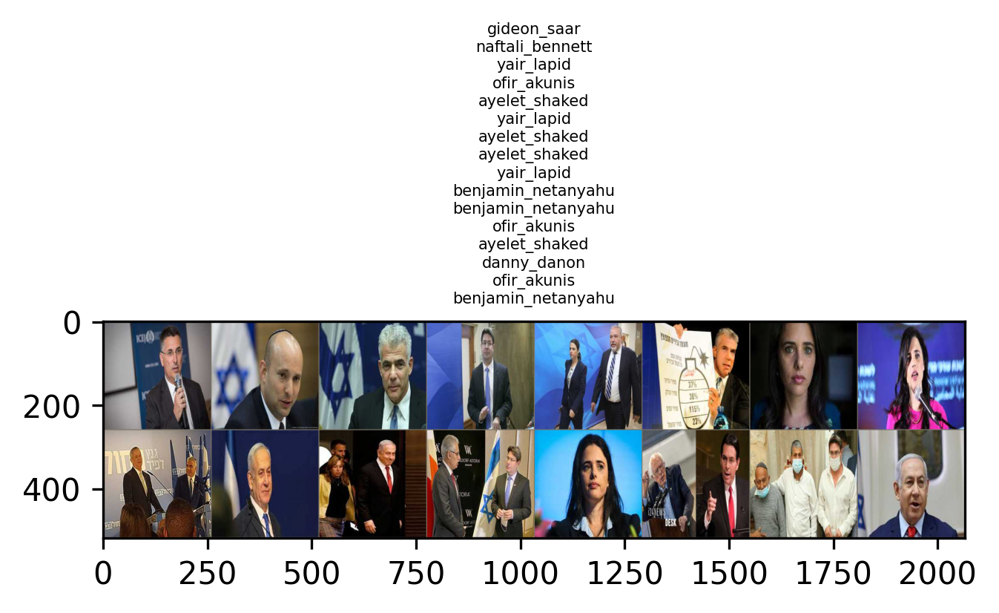

In [23]:
# Make a grid from batch
out = torchvision.utils.make_grid(inputs, nrow=8)

imshow(out, title='\n'.join([class_names[x] for x in classes]))

### Using a pretrained model
Let's load a model pretrained on ImageNet, and use it for our task.  
We will use the VGG16 network, that won the ImageNet Challenge in 2016.

The first time we load the model, it will be downloaded locally, and then cached for the future.

In [24]:
# We load a pretrain model with its weights. Alternatively, one might want to only load the model architecture.
model = models.vgg16(pretrained=True)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:11<00:00, 48.8MB/s]


We can print the model to learn about its structure as shown below.  
In future lessons, we will learn to read this output.  
For now, we can see that it is composed of 2D Convolution layers, non-linear ReLU activation, and 2D Max pooling, followed by a few fully connected layers. 

In [25]:
model 

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

Keras has a useful model summary, that we can also use for PyTorch models:

In [26]:
!pip install torchsummary 
from torchsummary import summary
summary(model.to(device), (3, 256, 256))

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
         MaxPool2d-5         [-1, 64, 128, 128]               0
            Conv2d-6        [-1, 128, 128, 128]          73,856
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]         147,584
              ReLU-9        [-1, 128, 128, 128]               0
        MaxPool2d-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 256, 64, 64]         295,168
             ReLU-12          [-1, 256, 64, 64]               0
    

We can see above that the final layer is a fully connected layer, from 4096 neurons to 1000 neurons, with a total of `4096 * 1000 + 1000 = 4,097,000` parameters. We add 1000 weights for the bias term of each output neuron.  

So in total, VGG-16 has 138M parameters, and we've set them all to be trainable.

However, VGG-16 and other networks created for ImageNet all have 1,000 neurons in their output, since they classify images to one of the 1,000 categories in the ImageNet challenge.  
To use the network for our task, we need to replace the final fully-connected layer with one mapping to 9 neurons instead of 1000:

In [27]:
# This code should output the number of input neurons to the final layer. We'll use it to create a new layer instead of it.
last_layer = list(model.children())[-1]
if hasattr(last_layer, 'in_features'):
  num_ftrs = last_layer.in_features
else:
  num_ftrs = last_layer[-1].in_features

num_ftrs

4096

To access and set a layer in the network, we reference it by name. In the example above, the final layer is `model.classifier[6]`.

In [28]:
# Here the size of each output sample is set to 2.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model.classifier[6]

Linear(in_features=4096, out_features=1000, bias=True)

Let's now replace it with a linear layer with 4096 input features and 9 output features:

In [29]:
model.classifier[6] = nn.Linear(in_features=4096, out_features=9)

Let's review our change in the model:

In [30]:
type(model)

torchvision.models.vgg.VGG

In [31]:
summary(model.to(device), (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
         MaxPool2d-5         [-1, 64, 128, 128]               0
            Conv2d-6        [-1, 128, 128, 128]          73,856
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]         147,584
              ReLU-9        [-1, 128, 128, 128]               0
        MaxPool2d-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 256, 64, 64]         295,168
             ReLU-12          [-1, 256, 64, 64]               0
           Conv2d-13          [-1, 256, 64, 64]         590,080
             ReLU-14          [-1, 256,

Next, we define the loss, optimizer and LR scheduler.

In [32]:
# If a GPU is available, make the model use it
model = model.to(device)

# For a multi-class problem, you'd usually prefer CrossEntropyLoss()
criterion = nn.CrossEntropyLoss()

# Use Stochastic Gradient Descent as the optimizer, with a learning rate of 0.001 and momentum
# Momentum simulates the corase of a heavy ball, and keeps moving in the direction of the previous gradient along with the new gradient. 
# Empirically it is known to show better convergence. We will learn about it in future lessons.
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

num_epochs = 10

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [33]:
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    # Init variables that will save info about the best model
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    epoch_loss_ls = []
    epoch_acc_ls = []

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                # Set model to training mode. 
                model.train()  
            else:
                # Set model to evaluate mode. In evaluate mode, we don't perform backprop and don't need to keep the gradients
                model.eval()   

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data
            for inputs, labels in dataloaders[phase]:
                # Prepare the inputs for GPU/CPU
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # ===== forward pass ======
                with torch.set_grad_enabled(phase=='train'):
                    # If we're in train mode, we'll track the gradients to allow back-propagation
                    outputs = model(inputs) # apply the model to the inputs. The output is the softmax probability of each class
                    _, preds = torch.max(outputs, 1) # the label with maximum probability
                    loss = criterion(outputs, labels) # the (training) loss for this epoch 

                    # ==== backward pass + optimizer step ====
                    # This runs only in the training phase
                    if phase == 'train':
                        loss.backward() # Perform a step in the opposite direction of the gradient
                        optimizer.step() # Adapt the optimizer

                # Collect statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                
            if phase == 'train':
                # Adjust the learning rate based on the scheduler
                scheduler.step()  

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]
            epoch_loss_ls.append(epoch_loss)
            epoch_acc_ls.append(epoch_acc.item())

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # Keep the results of the best model so far
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                # deepcopy the model
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {(time_elapsed // 60):.0f}m {(time_elapsed % 60):.0f}s')
    print(f'Best val Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, epoch_loss_ls, epoch_acc_ls

In [34]:
## MY code###
# Adapt the code above to plot the loss and the accuracy every epoch. Show both the training and the validation performance.  

def train_model_NL(model, dataloaders, criterion, optimizer, scheduler, num_epochs=5):
    since = time.time()

    # Init variables that will save info about the best model
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    epoch_loss_ls_val = []
    epoch_acc_ls_val = []
    epoch_loss_ls_train = []
    epoch_acc_ls_train = []

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                # Set model to training mode. 
                model.train()  
            else:
                # Set model to evaluate mode. In evaluate mode, we don't perform backprop and don't need to keep the gradients
                model.eval()   

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data
            for inputs, labels in dataloaders[phase]:
                # Prepare the inputs for GPU/CPU
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # ===== forward pass ======
                with torch.set_grad_enabled(phase=='train'):
                    # If we're in train mode, we'll track the gradients to allow back-propagation
                    outputs = model(inputs) # apply the model to the inputs. The output is the softmax probability of each class
                    _, preds = torch.max(outputs, 1) # 
                    loss = criterion(outputs, labels)

                    # ==== backward pass + optimizer step ====
                    # This runs only in the training phase
                    if phase == 'train':
                        loss.backward() # Perform a step in the opposite direction of the gradient
                        optimizer.step() # Adapt the optimizer

                # Collect statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                
            if phase == 'train':
                # Adjust the learning rate based on the scheduler
                scheduler.step()  
            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]
            if phase == 'train':
                epoch_loss_ls_train.append(epoch_loss)
                epoch_acc_ls_train.append(epoch_acc.item())
            else:
                epoch_loss_ls_val.append(epoch_loss)
                epoch_acc_ls_val.append(epoch_acc.item())

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # Keep the results of the best model so far
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                # deepcopy the model
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {(time_elapsed // 60):.0f}m {(time_elapsed % 60):.0f}s')
    print(f'Best val Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, epoch_acc_ls_val, epoch_acc_ls_train, epoch_loss_ls_val, epoch_loss_ls_train

## Finetuning the network




### Train and evaluate
It should take around 15-25 min on CPU. On GPU though, it takes less than a minute.

In [35]:
model, epoch_acc_ls_val, epoch_acc_ls_train, epoch_loss_ls_val, epoch_loss_ls_train = train_model_NL(model, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                       num_epochs=10)

Epoch 0/9
----------
train Loss: 1.7821 Acc: 0.3391
val Loss: 1.4141 Acc: 0.5043

Epoch 1/9
----------
train Loss: 1.1238 Acc: 0.6125
val Loss: 1.1367 Acc: 0.6111

Epoch 2/9
----------
train Loss: 0.5933 Acc: 0.8084
val Loss: 0.7200 Acc: 0.7521

Epoch 3/9
----------
train Loss: 0.2675 Acc: 0.9117
val Loss: 0.7597 Acc: 0.8034

Epoch 4/9
----------
train Loss: 0.2286 Acc: 0.9247
val Loss: 1.1053 Acc: 0.6880

Epoch 5/9
----------
train Loss: 0.1638 Acc: 0.9429
val Loss: 0.6619 Acc: 0.7778

Epoch 6/9
----------
train Loss: 0.0721 Acc: 0.9860
val Loss: 0.8531 Acc: 0.7564

Epoch 7/9
----------
train Loss: 0.0380 Acc: 0.9882
val Loss: 0.7313 Acc: 0.7863

Epoch 8/9
----------
train Loss: 0.0195 Acc: 0.9968
val Loss: 0.6974 Acc: 0.7991

Epoch 9/9
----------
train Loss: 0.0141 Acc: 0.9968
val Loss: 0.7073 Acc: 0.7991

Training complete in 3m 15s
Best val Acc: 0.803419


look at the parameters returned from the function:

In [36]:
print(epoch_acc_ls_val)
print(f'size of epoch_acc_ls_val{np.shape(epoch_acc_ls_val)}')
print(epoch_loss_ls_val)
print(f'size of epoch_loss_ls_val{np.shape(epoch_loss_ls_val)}')
print(epoch_acc_ls_train)
print(f'size of epoch_acc_ls_train{np.shape(epoch_acc_ls_train)}')

[0.5042735042735044, 0.6111111111111112, 0.7521367521367522, 0.8034188034188035, 0.6880341880341881, 0.7777777777777779, 0.7564102564102565, 0.7863247863247864, 0.7991452991452992, 0.7991452991452992]
size of epoch_acc_ls_val(10,)
[1.4141075203561375, 1.1366901642236955, 0.7199601373101912, 0.7597497530345224, 1.105276164272402, 0.6618921222467707, 0.8531175525779398, 0.731321371646009, 0.6973714150934138, 0.7073474491381238]
size of epoch_loss_ls_val(10,)
[0.33907427341227125, 0.61248654467169, 0.8083961248654467, 0.9117330462863293, 0.9246501614639396, 0.9429494079655543, 0.9860064585575887, 0.9881593110871905, 0.9967707212055973, 0.9967707212055973]
size of epoch_acc_ls_train(10,)


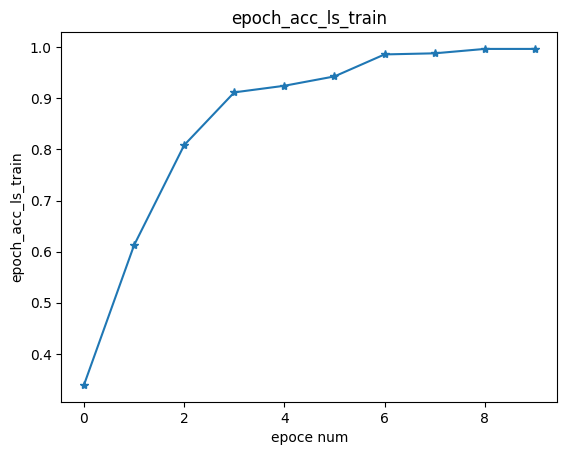

In [37]:
plt.figure()
plt.title("epoch_acc_ls_train")
plt.xlabel("epoce num")
plt.ylabel("epoch_acc_ls_train")
plt.plot(epoch_acc_ls_train,'-*')

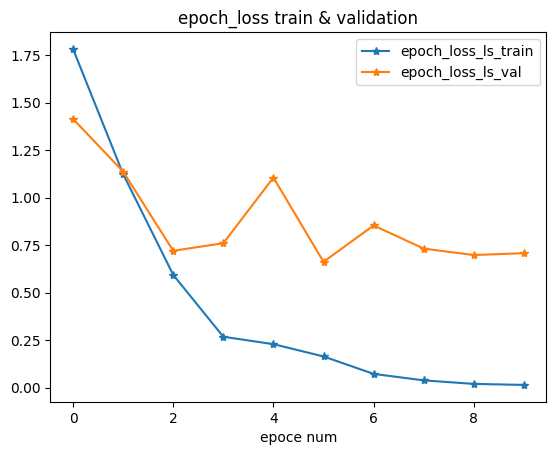

In [38]:
plt.figure()
plt.title("epoch_loss train & validation")
plt.xlabel("epoce num")
plt.plot(epoch_loss_ls_train,'-*')
plt.plot(epoch_loss_ls_val,'-*')
plt.legend(["epoch_loss_ls_train","epoch_loss_ls_val"])


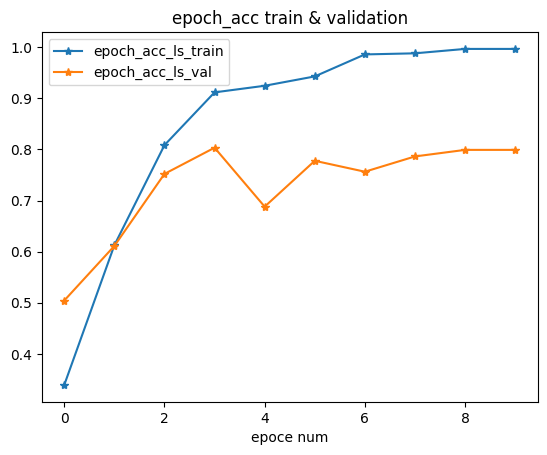

In [39]:
plt.figure()
plt.title("epoch_acc train & validation")
plt.xlabel("epoce num")
plt.plot(epoch_acc_ls_train,'-*')
plt.plot(epoch_acc_ls_val,'-*')
plt.legend(["epoch_acc_ls_train","epoch_acc_ls_val"])

### Visualizing the model predictions

Let's define a generic function to display our model's predictions for a few images:




In [40]:
def visualize_model(model, num_images=16):  # modified to print also true labels in the title  
    # Record the train/evaluate mode of the model, to restore it after we're done
    was_training = model.training
    # Set the model mode to evaluate
    model.eval()
    
    images_so_far = 0
    plt.figure(figsize=(2,1), dpi=300)

    with torch.no_grad(): # No need to collect gradients when generating predictions
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device) # true labels ########

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1) # predicted labels  ########

            for j in range(inputs.size()[0]):
                images_so_far += 1

                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title(f'predicted: {class_names[preds[j]]} true label: {class_names[labels[j]]}')
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
                
        # Restore the model's train/evaluate mode
        model.train(mode=was_training)

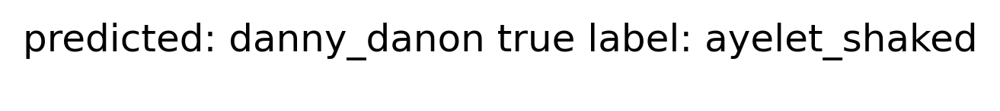

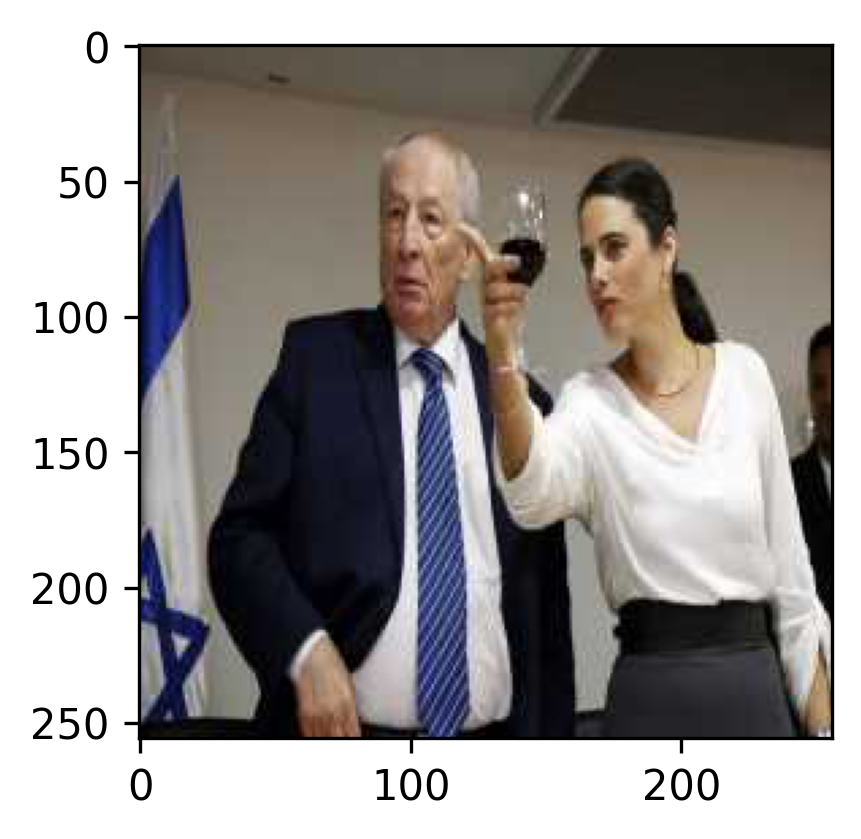

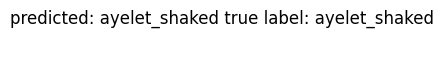

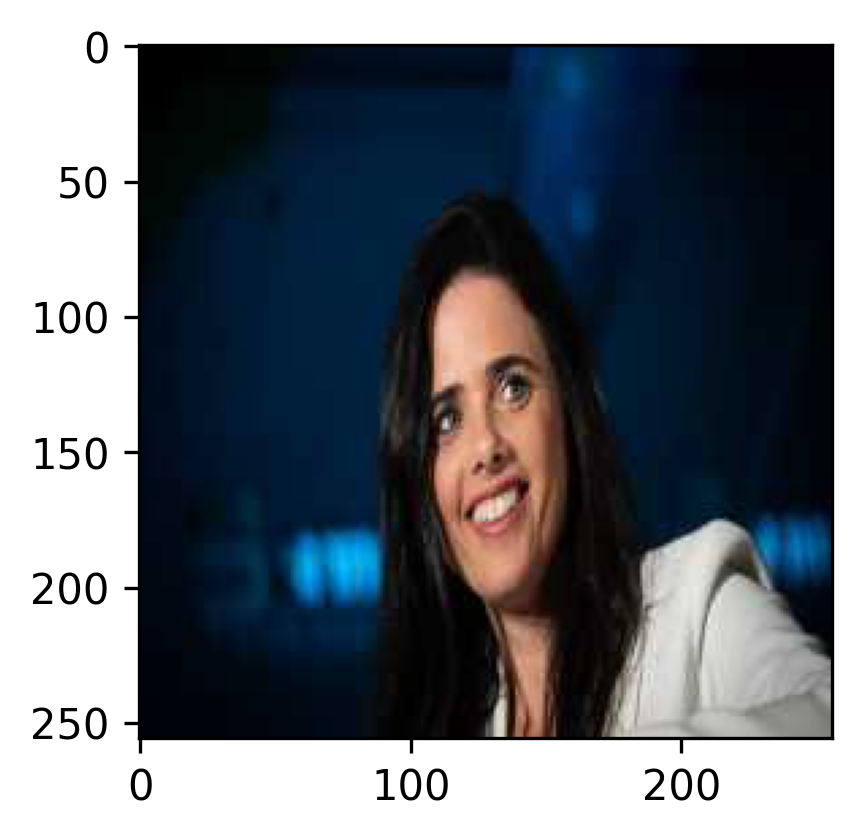

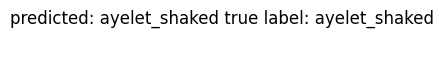

...

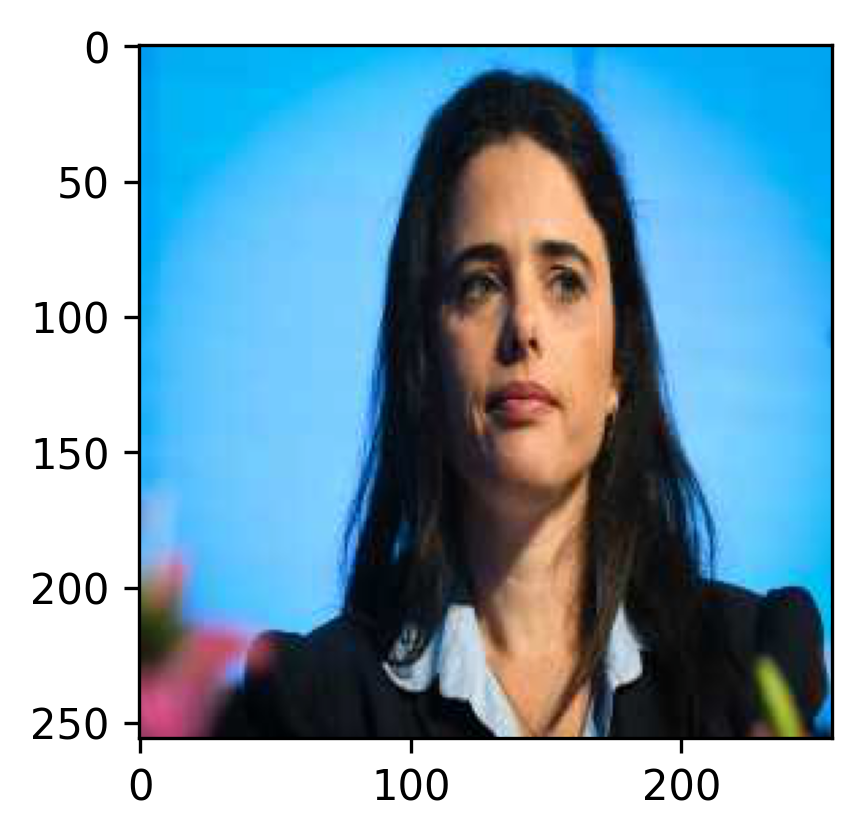

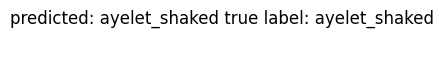

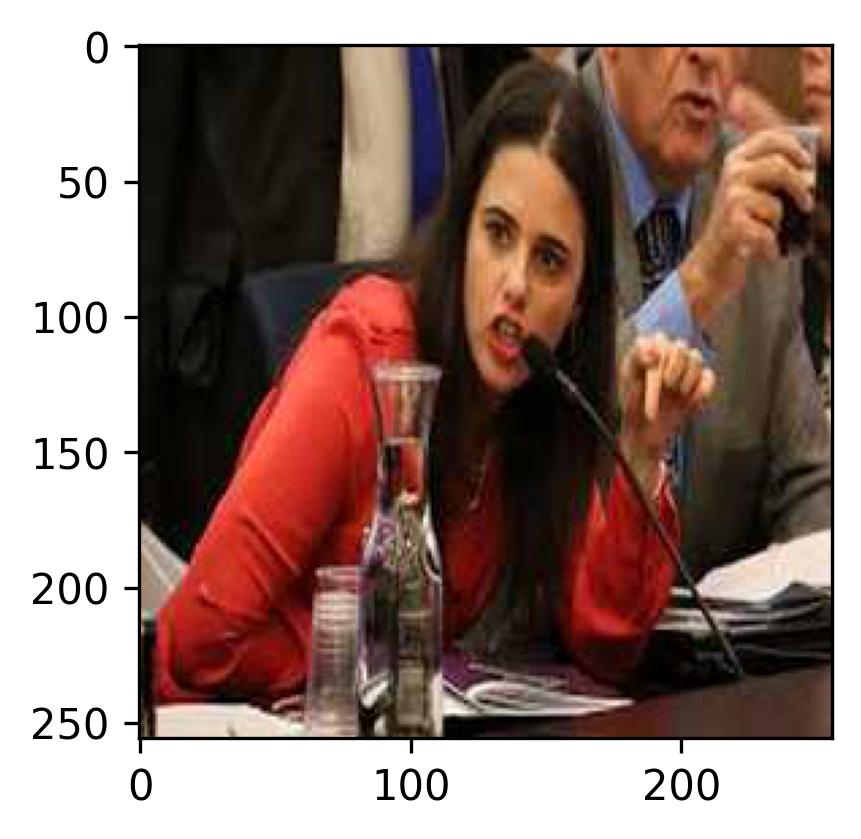

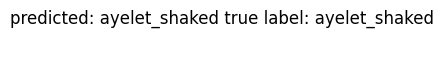

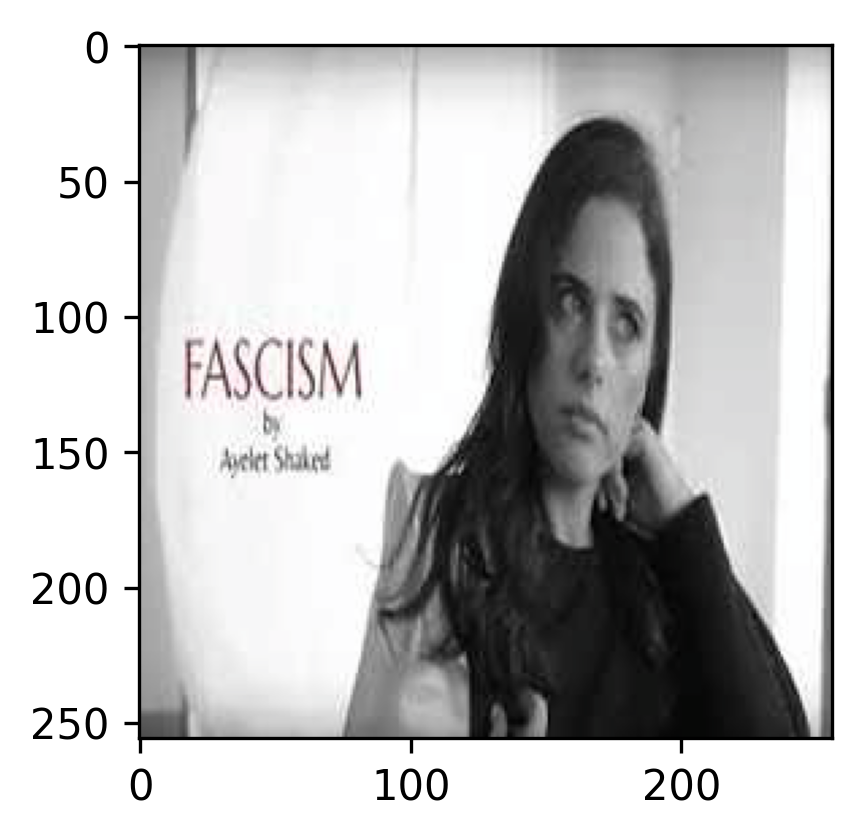

In [41]:
visualize_model(model) # why all images are from Ayelet Shaked??

# Additional Tasks
In the sections below, you'll experiment with PyTorch and NN yourself.  

Before you start having fun on your own, let's review together how to get some predictions from our trained model.  

As we've done in both our training and visualization code, we apply the model to input with the command:  
```python
outputs = model(inputs)
```

The relevant code:

In [42]:
inputs, labels = next(iter(dataloaders['train']))  # label changes with each run of this cell
inputs = inputs.to(device)

labels = labels.to(device)
print(labels)
[class_names[c] for c in labels.cpu().numpy()]

tensor([7, 2, 0, 3, 3, 1, 5, 1, 0, 5, 2, 4, 8, 6, 6, 6], device='cuda:0')


['ofir_akunis',
 'benny_gantz',
 'ayelet_shaked',
 'danny_danon',
 'danny_danon',
 'benjamin_netanyahu',
 'kostya_kilimnik',
 'benjamin_netanyahu',
 'ayelet_shaked',
 'kostya_kilimnik',
 'benny_gantz',
 'gideon_saar',
 'yair_lapid',
 'naftali_bennett',
 'naftali_bennett',
 'naftali_bennett']

In [43]:
type(labels)

torch.Tensor

Note that we got tensors. We can convert them into numpy objects. Since we've previously set them to use GPU, We'll need to set them to use CPU first:

In [44]:
labels.cpu().numpy()

array([7, 2, 0, 3, 3, 1, 5, 1, 0, 5, 2, 4, 8, 6, 6, 6])

In [45]:
outputs = model(inputs)

print(outputs.shape)
print(outputs)

torch.Size([16, 9])
tensor([[-8.6544e-01, -3.5839e+00, -4.2576e+00,  2.5346e+00,  6.3305e-01,
         -1.5059e+00, -1.8258e+00,  7.5140e+00,  8.7571e-01],
        [-1.6057e+00,  1.2253e+00,  5.8791e+00, -2.7236e+00, -1.0787e+00,
         -2.5198e+00,  1.8835e+00, -3.5201e+00,  1.6840e+00],
        [ 9.3575e+00, -4.4534e+00, -3.8414e+00,  8.0518e-01, -2.3735e+00,
         -5.5128e-01,  2.4134e+00, -3.6477e-01, -5.8213e-01],
        [ 1.1456e+00, -3.9456e+00, -5.6925e+00,  8.5341e+00,  9.6018e-01,
         -2.4472e+00,  5.2070e-01,  3.6712e+00, -2.5954e+00],
        [ 2.4948e+00, -2.2632e+00, -7.2558e+00,  9.0262e+00, -1.3307e+00,
         -3.7530e+00,  5.6326e-01,  1.9383e+00, -4.5735e-01],
        [-4.4921e+00,  9.9247e+00,  2.6677e+00, -5.9699e-01,  7.7210e-01,
         -1.6447e+00, -2.4971e+00, -2.6829e+00, -1.0856e+00],
        [ 1.7108e+00, -3.7168e+00, -2.1033e+00,  6.7828e-01,  2.5226e+00,
          5.8620e+00, -2.0553e+00, -1.8700e-01, -2.0971e-01],
        [-1.5636e+00,  5.051

Note that `outputs` have 16 "rows", one for each of the images in our batch, and each "row" has 9 values, for each of our classes.  
The values are the activations of the neurons, before applying the softmax function to them. To apply the softmax function to them, we can run:

In [46]:
torch.nn.functional.softmax(outputs, dim=1).cpu().detach().numpy() # the outputs is the "scores" after applying softmax on the values of last layer. each raw is for one image in the input

array([[2.27334429e-04, 1.49979915e-05, 7.64659035e-06, 6.81201182e-03,
        1.01729750e-03, 1.19813856e-04, 8.70173462e-05, 9.90417242e-01,
        1.29668391e-03],
       [5.37409273e-04, 9.11565311e-03, 9.56941783e-01, 1.75712659e-04,
        9.10207571e-04, 2.15433887e-04, 1.76040288e-02, 7.92289866e-05,
        1.44205494e-02],
       [9.98675525e-01, 1.00336740e-06, 1.85030547e-06, 1.92845910e-04,
        8.03055809e-06, 4.96718567e-05, 9.63069324e-04, 5.98561273e-05,
        4.81626266e-05],
       [6.12703559e-04, 3.76831485e-06, 6.56843838e-07, 9.90856647e-01,
        5.08985075e-04, 1.68615552e-05, 3.27973452e-04, 7.65777566e-03,
        1.45395479e-05],
       [1.45316357e-03, 1.24719791e-05, 8.46629007e-08, 9.97380316e-01,
        3.16898004e-05, 2.81135044e-06, 2.10595186e-04, 8.32917343e-04,
        7.58936148e-05],
       [5.47653315e-07, 9.99128759e-01, 7.04636099e-04, 2.69231805e-05,
        1.05855892e-04, 9.44291605e-06, 4.02626165e-06, 3.34357833e-06,
        1.6

In [47]:
np.shape(torch.nn.functional.softmax(outputs, dim=1).cpu().detach().numpy())

(16, 9)

## Task 1: Plot model convergence
Adapt the code above to plot the loss and the accuracy every epoch. Show both the training and the validation performance.  
Does our model overfit?  
Do you have suggestions following these graphs? 

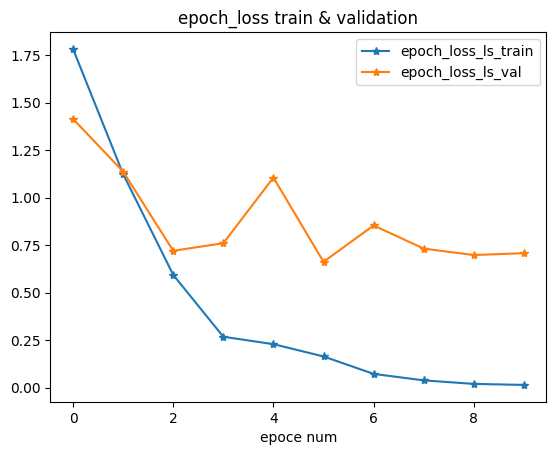

In [48]:
plt.figure()
plt.title("epoch_loss train & validation")
plt.xlabel("epoce num")
plt.plot(epoch_loss_ls_train,'-*')
plt.plot(epoch_loss_ls_val,'-*')
plt.legend(["epoch_loss_ls_train","epoch_loss_ls_val"])


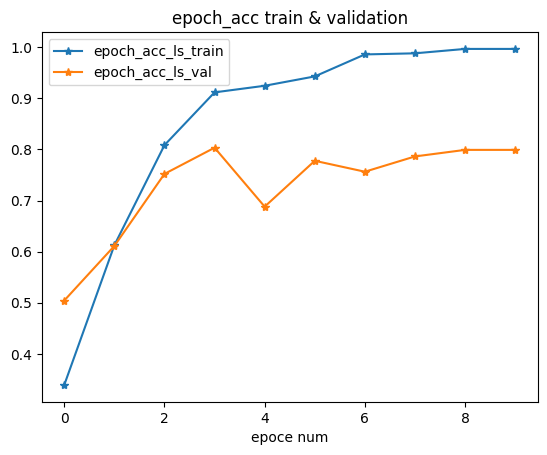

In [49]:
plt.figure()
plt.title("epoch_acc train & validation")
plt.xlabel("epoce num")
plt.plot(epoch_acc_ls_train,'-*')
plt.plot(epoch_acc_ls_val,'-*')
plt.legend(["epoch_acc_ls_train","epoch_acc_ls_val"])

We can see that after epoch 2 the model overfits. The training accuracy is higher than the validation accuracy and training loss is lower than the validation loss. 
Based on these graphs, we probably should stop the epoch iterations after epoch=2.

## Task 2: Evaluate the model performance
Write code that shows the performance of our model.  
Show the classification report and the confusion matrix.  

What can you say about the model so far?  
Can you suggest a few ideas to improve it?

In [50]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

## ANSWER
##### to show conf_max we need to compare the true and predicted labels for the input images.
we wrote a func that go over all "val" images, and calc predicted labels.
 then we take the full list of true and pred and calc matrix and report.

In [51]:
inputs, labels = next(iter(dataloaders['val']))  # label changes with each run of this cell
inputs = inputs.to(device)
labels = labels.to(device)
[class_names[c] for c in labels.cpu().numpy()]
labels.cpu().numpy()
outputs = model(inputs)

In [52]:
def model_predict(model, num_images, set):  # modified to print also true labels in the title  
    # Record the train/evaluate mode of the model, to restore it after we're done
    was_training = model.training
    # Set the model mode to evaluate
    model.eval()
    labels_ls = [] # empty list of labels (val)
    preds_ls = [] # empty list of predictions (val)
    with torch.no_grad(): # No need to collect gradients when generating predictions
        for i, (inputs, labels) in enumerate(dataloaders[set]):
            inputs = inputs.to(device)
            labels = labels.to(device) # true labels ########
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1) # predicted labels  ########

            for j in range(inputs.size()[0]):
                labels_ls.append(labels[j].cpu().numpy())
                preds_ls.append(preds[j].cpu().numpy())
                # outputs_ls.append(outputs[j])
        # Restore the model's train/evaluate mode
        model.train(mode=was_training)
    return labels_ls,preds_ls

In [53]:
# working of val matrix:
labels_ls, preds_ls = model_predict(model, num_images=16, set='val') 

In [54]:
print(classification_report(labels_ls, preds_ls))

              precision    recall  f1-score   support

           0       0.92      0.96      0.94        24
           1       0.87      0.79      0.83        58
           2       0.67      0.36      0.47        22
           3       0.83      0.86      0.84        22
           4       0.95      0.75      0.84        24
           5       0.75      1.00      0.86         3
           6       0.76      0.70      0.73        23
           7       0.78      0.94      0.85        34
           8       0.64      0.96      0.77        24

    accuracy                           0.80       234
   macro avg       0.80      0.81      0.79       234
weighted avg       0.81      0.80      0.80       234



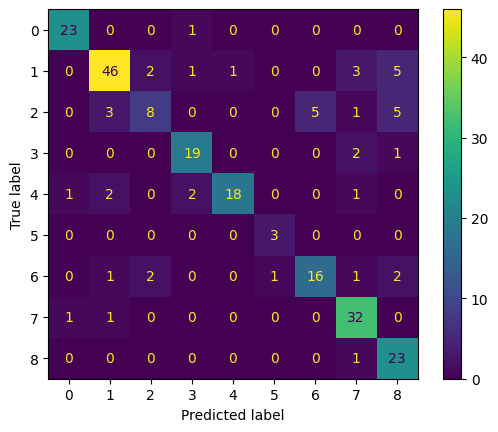

In [55]:
cm_val = confusion_matrix(labels_ls, preds_ls)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_val)
disp.plot()
plt.show()

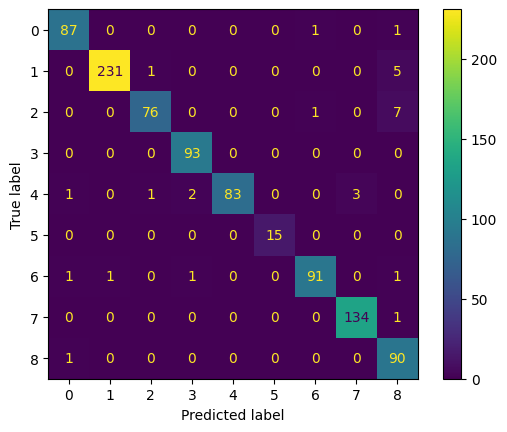

In [56]:
# working of training set
labels_ls, preds_ls = model_predict(model, num_images=16, set='train')
cm_train = confusion_matrix(labels_ls, preds_ls)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_train)
disp.plot()
plt.show()

In [57]:
print(classification_report(labels_ls, preds_ls))

              precision    recall  f1-score   support

           0       0.97      0.98      0.97        89
           1       1.00      0.97      0.99       237
           2       0.97      0.90      0.94        84
           3       0.97      1.00      0.98        93
           4       1.00      0.92      0.96        90
           5       1.00      1.00      1.00        15
           6       0.98      0.96      0.97        95
           7       0.98      0.99      0.99       135
           8       0.86      0.99      0.92        91

    accuracy                           0.97       929
   macro avg       0.97      0.97      0.97       929
weighted avg       0.97      0.97      0.97       929



#### What can you say about the model so far?  
#### Can you suggest a few ideas to improve it?

Obviously the model is overfitter, since we have 80% accuracy on Validation and 100% accuracy on the Train.
so we probably should apply early-stop.

we can see that label "2" = "Benny Gantz"  and also "5" = "Kosta" have a low presicion and recall. that means we need more sampeles (images) of these classes.


## Task 3: Perform Error Analysis 
Error Analysis is an extremely important practice in Machine Learning research. It is rare that our base model works great out of the box. Proper error analysis helps us detect and fix issues in our DL code, data preprocessing and even in the data itself.

#### Review examples of top errors
One of the basic techniques of Error Analysis is manually reviewing the top errors of the model - samples where the model was most confident about one class, but the true label was different.  
Plot the top 10 errors of the model for each true class.  
Do you spot any issue or pattern?  
Try to see if you can improve the performance of the model following your insights.

## ANSWER

## Training data exploration
Following OH, we decided to take a look on the trainig set and true labels - are they realy true?
(we used the visualization function from the notebook above)

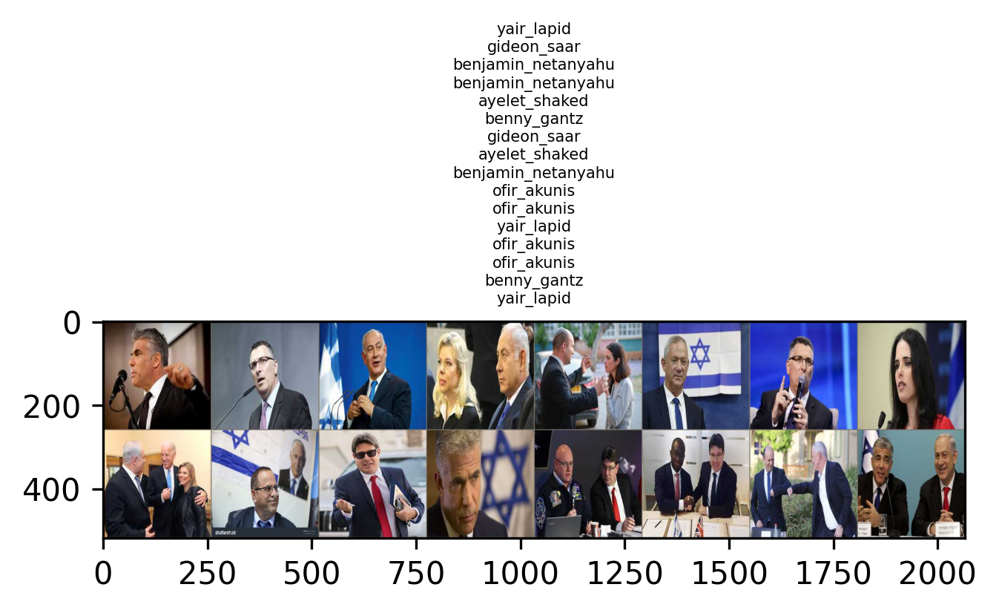

In [59]:
inputs, classes = next(iter(dataloaders['train']))
out = torchvision.utils.make_grid(inputs, nrow=8)
imshow(out, title='\n'.join([class_names[x] for x in classes]))

( see attached captures - additional to the notebook)

1. we can see an image of *Lihi Lapid* classified as *Yair lapid* (missleading trainning for the model)
2. also we can see an image of *Ben Caspit* - also not matching any option in the list of classes, but still classified as *Yair Lapid*
3. in Training_set_3 an image including both *Bibi* and *Gideon* was classified as *Bibi*, this might also confuse the model

 - we indeed see in the confusion matrix that Bibi and Gideon can be wrongly classified with each other. but we don't see much confusion between Yair to other classes. this might be due to the fact that Yair has a lot of training samples.

## Confusion Matrix exploration
look on to the confusion matrix and check what are the most common mistakes in the validation set:


In [60]:
# training-set conf-matrix
labels_ls, preds_ls = model_predict(model, num_images=16, set='train') 
cm_train = confusion_matrix(labels_ls, preds_ls)
temp_cm = cm_train.copy()
np.fill_diagonal(temp_cm, -1) #  diagonal = -1
error_ind = np.argmax(temp_cm, axis=1) # Find the inds of  max value
error_val = np.max(temp_cm, axis=1) # Find the max value

for a, b in enumerate(error_ind):
    if error_val[a] > 0:  # Print  false classifications 
        print(f'{class_names[a]}\t is usually wrongly classified as \t{class_names[b]}')

ayelet_shaked	 is usually wrongly classified as 	naftali_bennett
benjamin_netanyahu	 is usually wrongly classified as 	yair_lapid
benny_gantz	 is usually wrongly classified as 	yair_lapid
gideon_saar	 is usually wrongly classified as 	ofir_akunis
naftali_bennett	 is usually wrongly classified as 	ayelet_shaked
ofir_akunis	 is usually wrongly classified as 	yair_lapid
yair_lapid	 is usually wrongly classified as 	ayelet_shaked


In [61]:
# validation conf-matrix
labels_ls, preds_ls = model_predict(model, num_images=16, set='val') 
cm_val = confusion_matrix(labels_ls, preds_ls)

temp_cm = cm_val.copy()
np.fill_diagonal(temp_cm, -1) #  diagonal = -1
error_ind = np.argmax(temp_cm, axis=1) # Find the inds of  max value
error_val = np.max(temp_cm, axis=1) # Find the max value

for a, b in enumerate(error_ind):
    if error_val[a] > 0:  # Print  false classifications 
        print(f'{class_names[a]}\t is usually wrongly classified as \t{class_names[b]}')

ayelet_shaked	 is usually wrongly classified as 	danny_danon
benjamin_netanyahu	 is usually wrongly classified as 	yair_lapid
benny_gantz	 is usually wrongly classified as 	naftali_bennett
danny_danon	 is usually wrongly classified as 	ofir_akunis
gideon_saar	 is usually wrongly classified as 	benjamin_netanyahu
naftali_bennett	 is usually wrongly classified as 	benny_gantz
ofir_akunis	 is usually wrongly classified as 	ayelet_shaked
yair_lapid	 is usually wrongly classified as 	ofir_akunis


## Plot the top 10 errors of the model for each true class.  

the top errors are: the errors where we paid the largest losses
so where the loss is the largest?


In [62]:
def plot_top_errors(model, phase, num_images=10):    
    # Record the train/evaluate mode of the model, to restore it after we're done
    was_training = model.training
    # Set the model mode to evaluate
    model.eval()

    error_dict_imgs = {key_list: [] for key_list in range(10)}
    error_dict_preds = {key_list: [] for key_list in range(10)}
    error_dict_loss = {key_list: [] for key_list in range(10)}
    
    plt.figure(figsize=(1,1), dpi=200)

    with torch.no_grad(): # No need to collect gradients when generating predictions
        for i, (inputs, labels) in enumerate(dataloaders[phase]):
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model(inputs)

            _, preds = torch.max(outputs, 1)

            for l, p, input, output in zip(labels, preds, inputs, outputs):
                if l != p:  # False prediction
                    loss = criterion(output, l)
                    # error_dict is a dicionary, where the keys are the true labels, and the values are lists of tensors
                    if len(error_dict_imgs[l.item()]) < 10: # Collecting the first 10
                        # Collecting the false-classified tensors
                        error_dict_imgs[l.item()].append(input)
                        # Collecting the wrong predictions
                        error_dict_preds[l.item()].append(class_names[p.item()])
                        # Collecting the loss
                        error_dict_loss[l.item()].append(loss.item())
        
        for lab, tensors in error_dict_imgs.items():
            if len(tensors) > 0:
                # sorting and get top 10 error (loss-wise)
                loss_indxs = np.argsort(error_dict_loss[lab])[::-1][:10]
                error_preds = [error_dict_preds[lab][i] for i in loss_indxs]
                tens_to_plot = [tensors[i] for i in loss_indxs]
                title = f'True label: {class_names[lab]} | Predicted: (in decsending loss order) {", ".join(error_preds)}'
                out = torchvision.utils.make_grid(tensors, nrow=5)
                imshow(out.cpu(), title=title)
                
        # Restore the model's train/evaluate mode
        model.train(mode=was_training)

<Figure size 200x200 with 0 Axes>

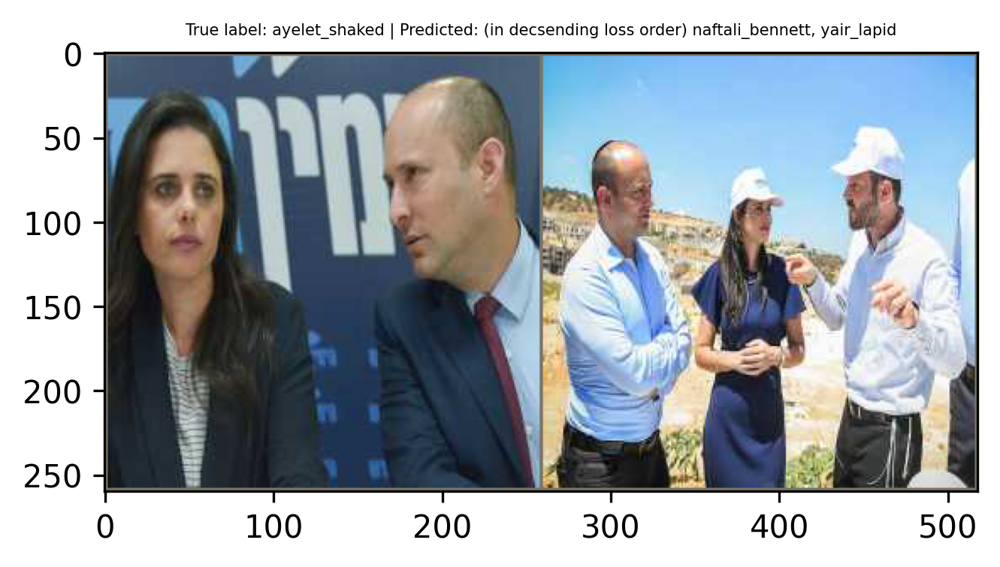

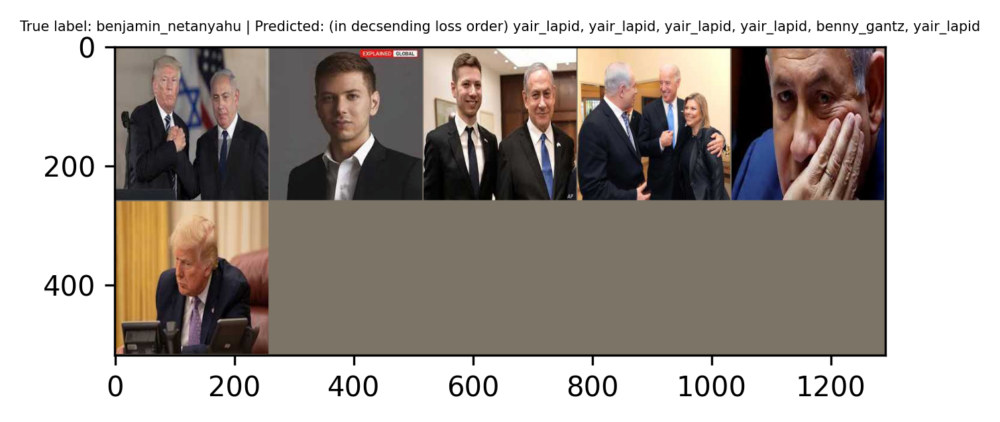

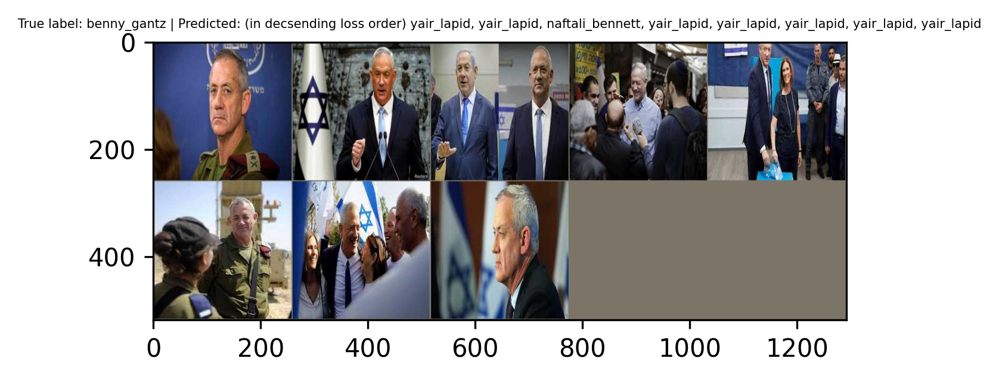

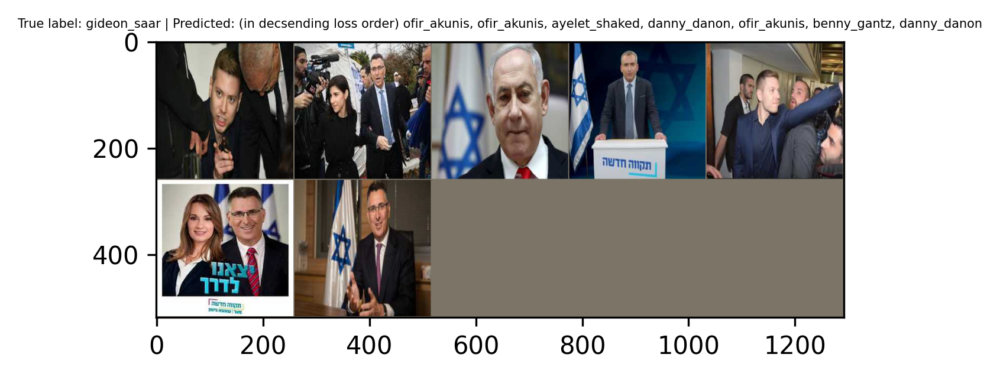

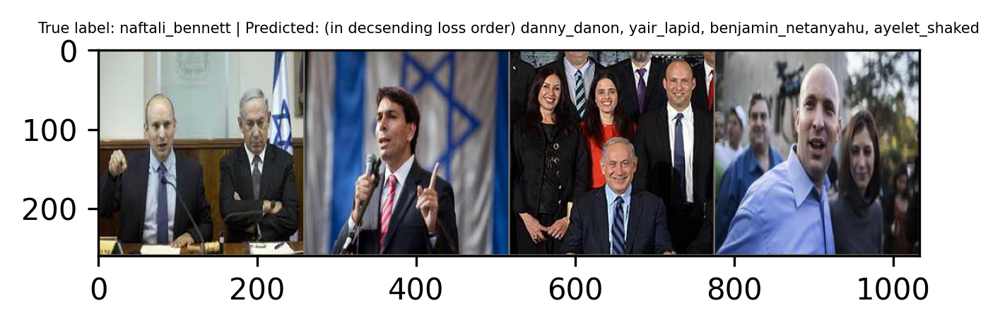

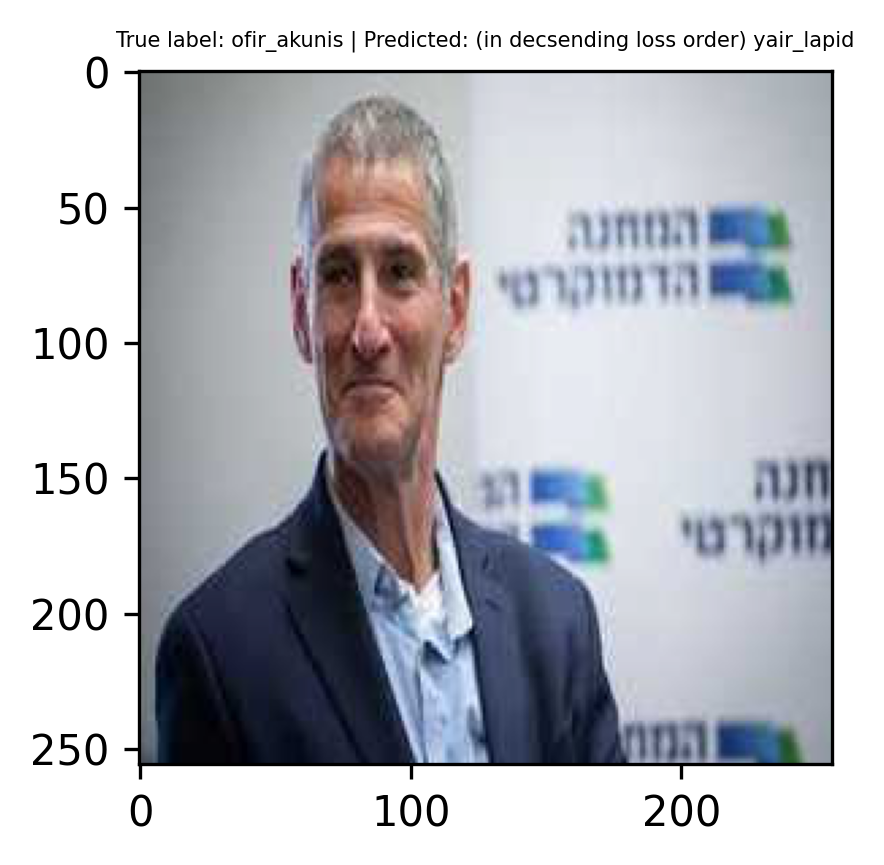

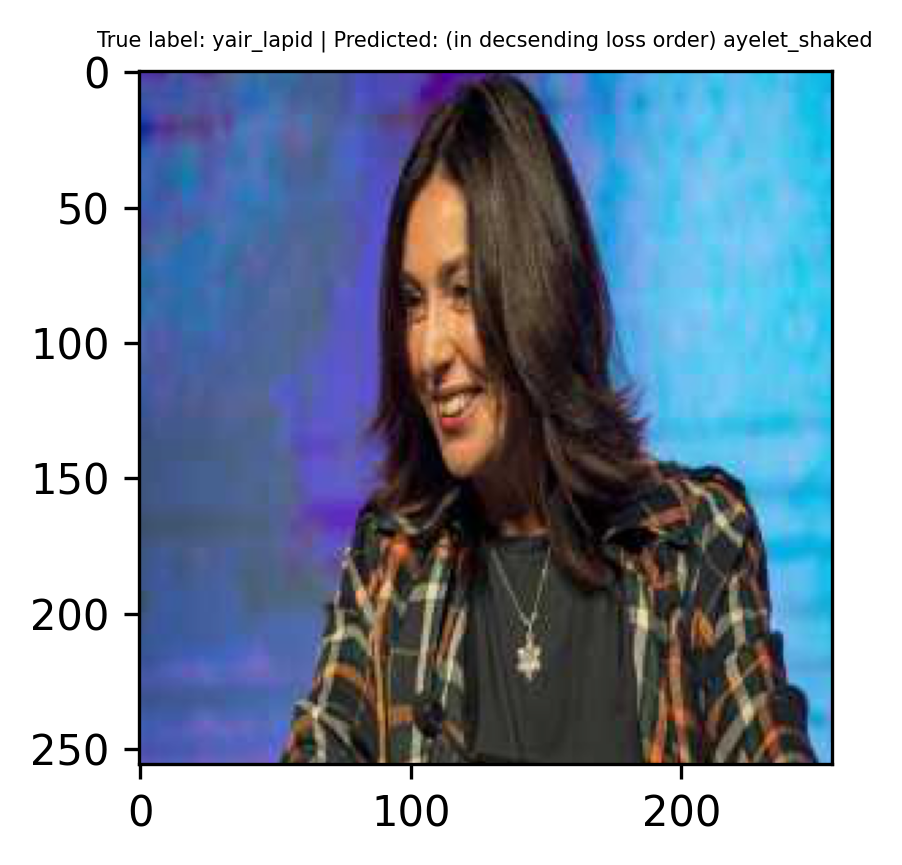

In [63]:
plot_top_errors(model, 'train')

<Figure size 200x200 with 0 Axes>

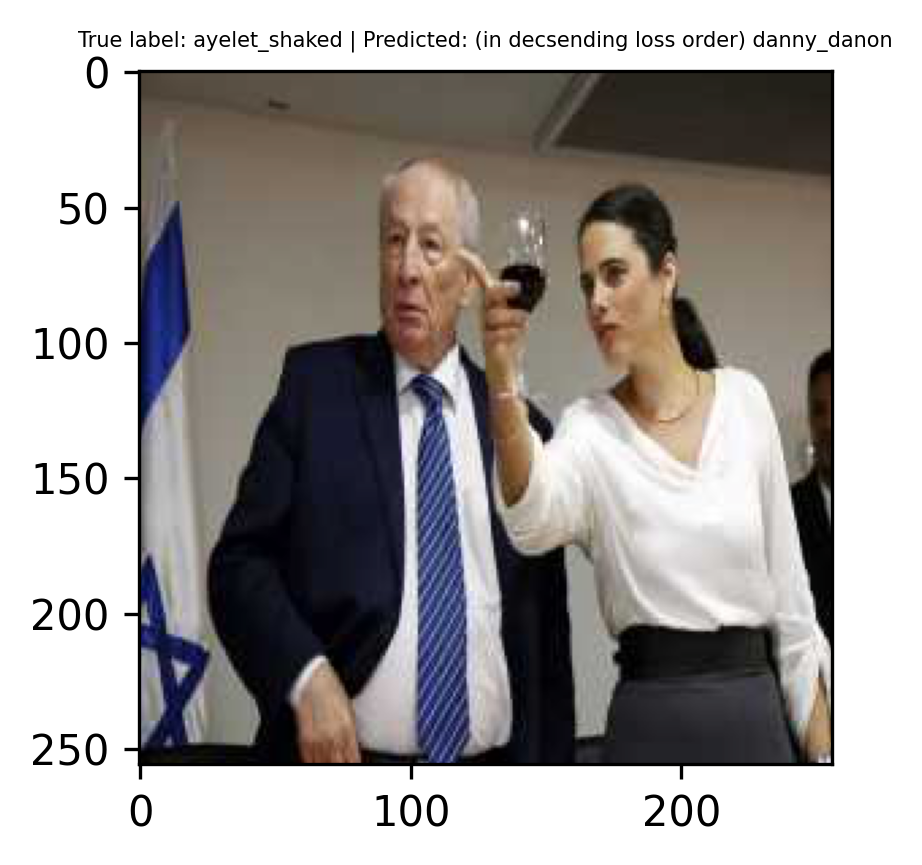

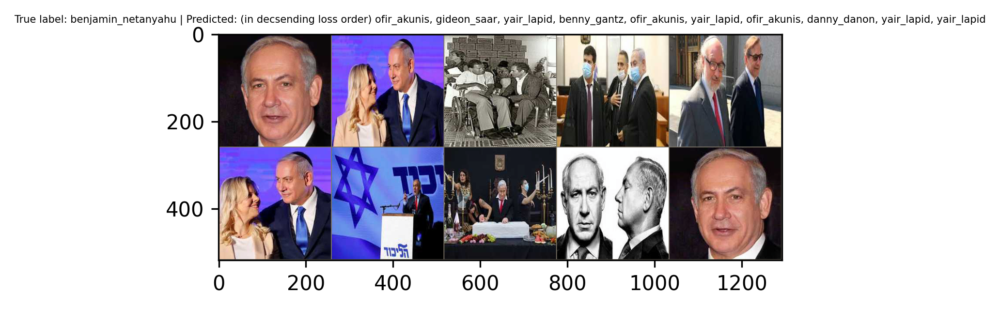

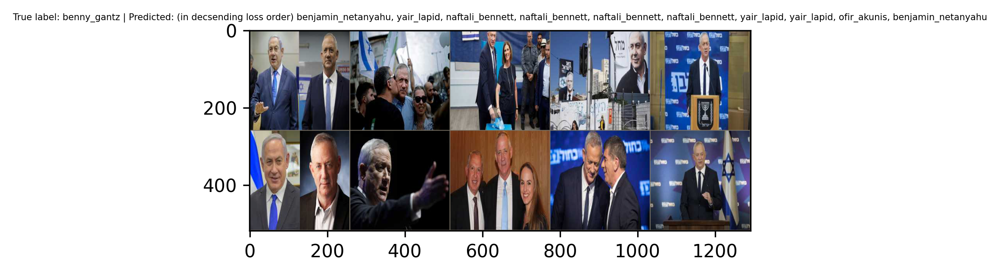

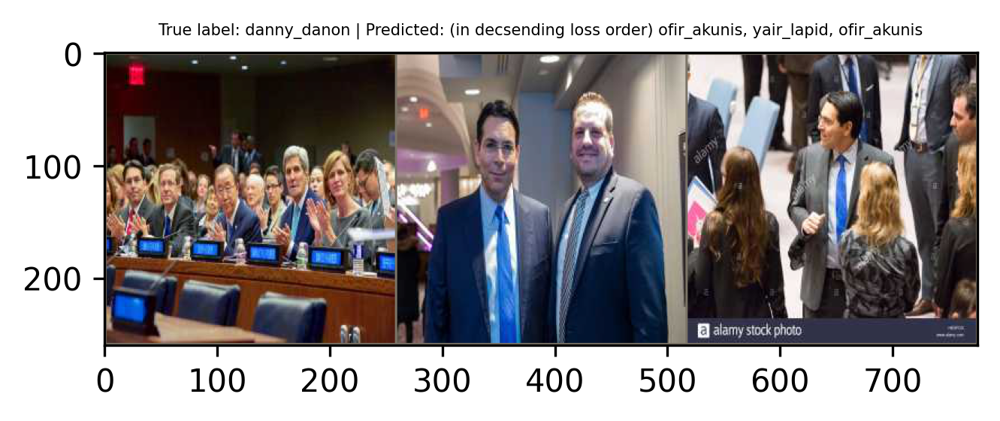

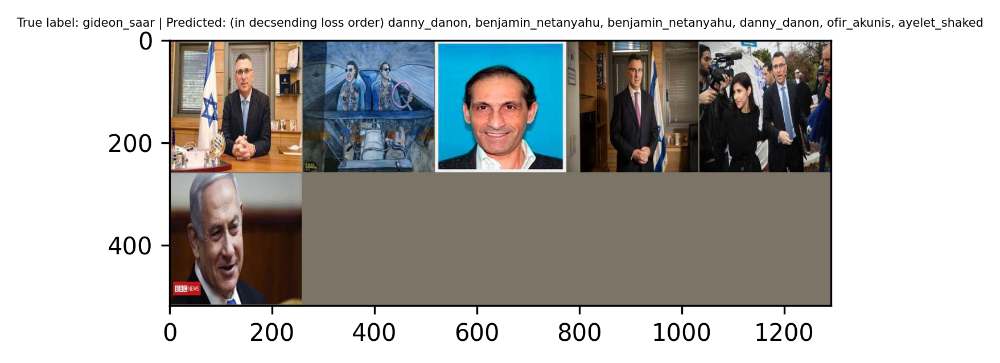

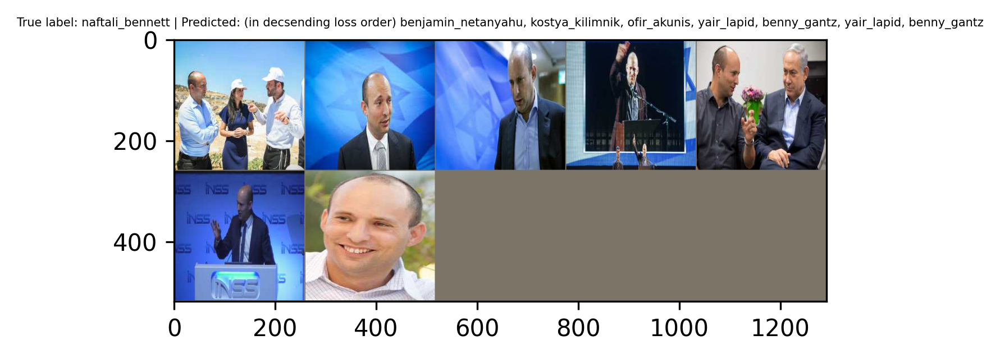

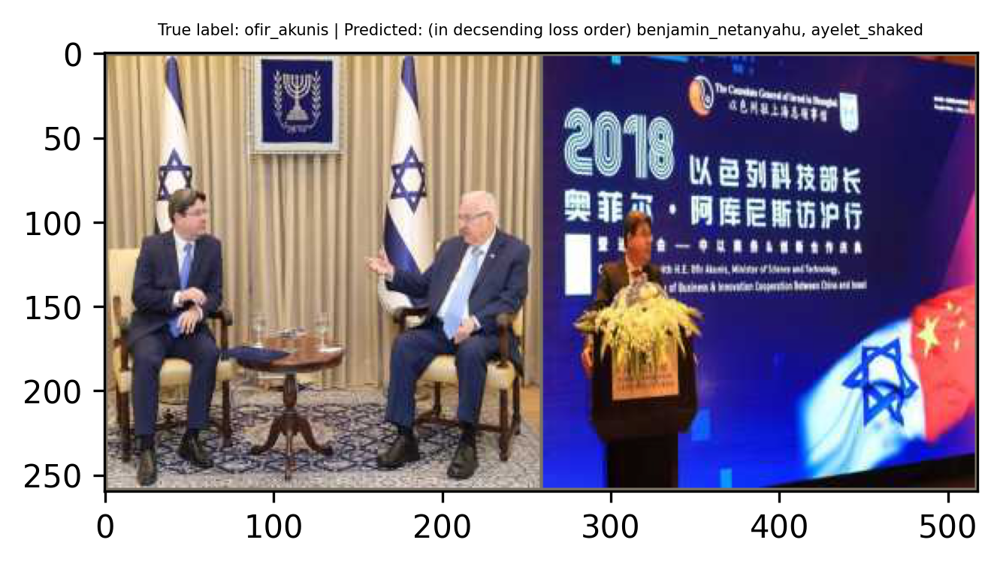

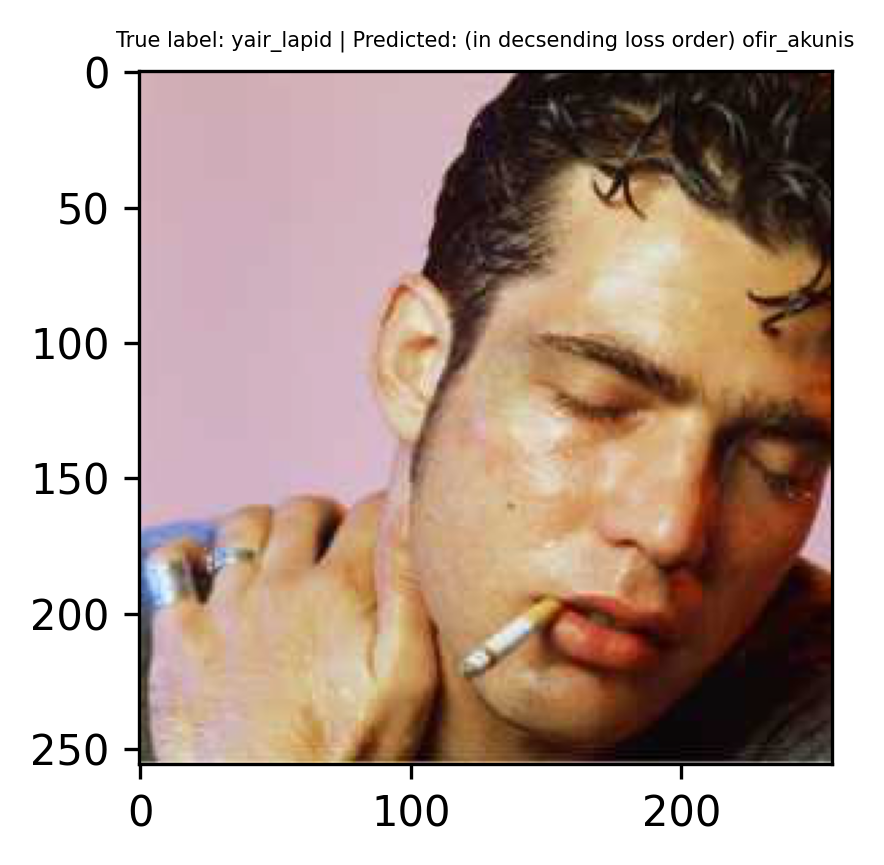

In [64]:
plot_top_errors(model, 'val')

## Do you spot any issue or pattern?  
1. the data set is not balanced. there are more samples of some of the classes than the rest (as shown in the classification report).
2. the data set includes images with more than one person, and the label includes only 1 person.
3. the true label is not always correct.



## Task 4: Data Augmentation
Manually labeling can be expensive, both in terms of money and of time. Data augmentations serve to increase the amount of data available for the classifier without requiring labeling more images.  

The torch vision package allows easy augmentation of images using the data transforms.  
Use and adapt the code below to try different augmentations, and discuss the results and the model improvements you got from these augmentations.

[This guide](https://www.analyticsvidhya.com/blog/2019/12/image-augmentation-deep-learning-pytorch/) might help you along the way.

## ANSWER

### Original data

In [65]:
## first initializing the model so we don't have over-fitting:
# running same code from above to initialize the model
model = models.vgg16(pretrained=True)
model.classifier[6] = nn.Linear(in_features=4096, out_features=9)
model = model.to(device)
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

In [66]:
# Original data loaders

means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}


In [67]:
# Training of original train data and get accuracy result
# choose the original 9 epochs
# see the loss and accuracy along the epochs so we can compare the the augmented dataset training

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}

model, epoch_acc_ls_val, epoch_acc_ls_train, epoch_loss_ls_val, epoch_loss_ls_train = train_model_NL(model, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                       num_epochs=10)

Epoch 0/9
----------
train Loss: 1.7265 Acc: 0.3875
val Loss: 1.3027 Acc: 0.5214

Epoch 1/9
----------
train Loss: 0.9959 Acc: 0.6631
val Loss: 1.0107 Acc: 0.6752

Epoch 2/9
----------
train Loss: 0.6893 Acc: 0.7675
val Loss: 0.9305 Acc: 0.6709

Epoch 3/9
----------
train Loss: 0.3458 Acc: 0.8934
val Loss: 0.9452 Acc: 0.7692

Epoch 4/9
----------
train Loss: 0.1938 Acc: 0.9419
val Loss: 0.7450 Acc: 0.7778

Epoch 5/9
----------
train Loss: 0.1028 Acc: 0.9720
val Loss: 1.1689 Acc: 0.7479

Epoch 6/9
----------
train Loss: 0.0708 Acc: 0.9785
val Loss: 0.8333 Acc: 0.8034

Epoch 7/9
----------
train Loss: 0.0485 Acc: 0.9892
val Loss: 0.9497 Acc: 0.7778

Epoch 8/9
----------
train Loss: 0.2945 Acc: 0.9171
val Loss: 0.7163 Acc: 0.7863

Epoch 9/9
----------
train Loss: 0.0591 Acc: 0.9849
val Loss: 0.6766 Acc: 0.7906

Training complete in 3m 20s
Best val Acc: 0.803419


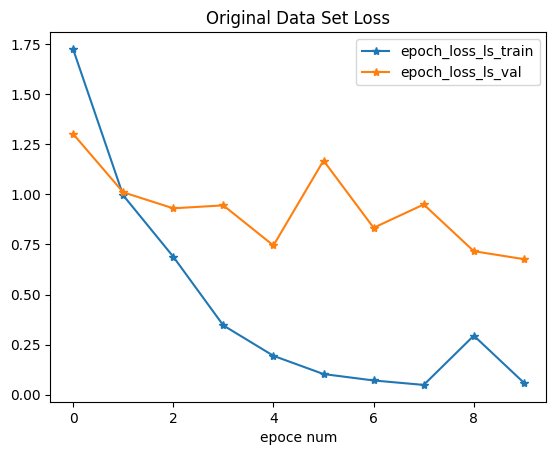

In [68]:
plt.figure()
plt.title("Original Data Set Loss")
plt.xlabel("epoce num")
plt.plot(epoch_loss_ls_train,'-*')
plt.plot(epoch_loss_ls_val,'-*')
plt.legend(["epoch_loss_ls_train","epoch_loss_ls_val"])

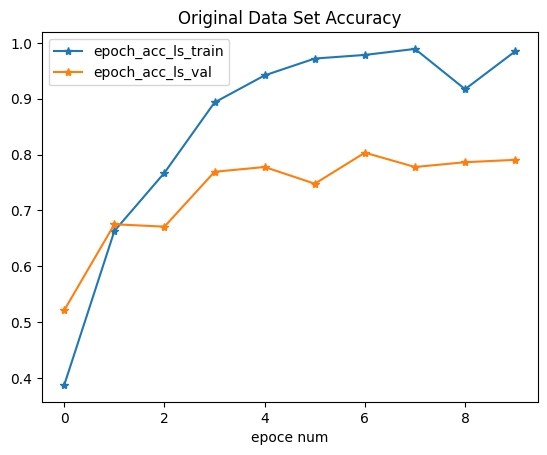

In [69]:
plt.figure()
plt.title("Original Data Set Accuracy")
plt.xlabel("epoce num")
plt.plot(epoch_acc_ls_train,'-*')
plt.plot(epoch_acc_ls_val,'-*')
plt.legend(["epoch_acc_ls_train","epoch_acc_ls_val"])

In [70]:
# Predict and recive score:
labels_ls, preds_ls = model_predict(model, num_images=16, set='val')
print("accuracy_score for original data set")
acc_score_original = accuracy_score(labels_ls, preds_ls)

accuracy_score for original data set


CM for original dataset


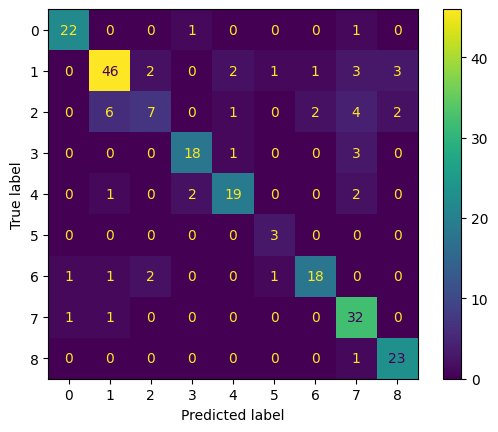

In [71]:
cm_val = confusion_matrix(labels_ls, preds_ls)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_val)
disp.plot()
print("CM for original dataset")
plt.show()

### augmented data (RandomHorizontalFlip)

In [72]:
## first initializing the model so we don't have over-fitting:
# running same code from above to initialize the model
model = models.vgg16(pretrained=True)
model.classifier[6] = nn.Linear(in_features=4096, out_features=9)
model = model.to(device)
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

In [73]:
# augmented data set:
data_transforms_aug = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.RandomHorizontalFlip(), # adding this ogmantation method "flip" - guess it is not the best one..
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

In [74]:
# Training of augmented train data and get accuracy result
# choose the original 9 epochs
# see the loss and accuracy along the epochs so we can compare the the augmented dataset training

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms_aug[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}

model, epoch_acc_ls_val, epoch_acc_ls_train, epoch_loss_ls_val, epoch_loss_ls_train = train_model_NL(model, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                       num_epochs=10)

Epoch 0/9
----------
train Loss: 1.8060 Acc: 0.3520
val Loss: 1.4205 Acc: 0.4786

Epoch 1/9
----------
train Loss: 1.1585 Acc: 0.5877
val Loss: 0.9890 Acc: 0.6325

Epoch 2/9
----------
train Loss: 0.7074 Acc: 0.7664
val Loss: 0.7294 Acc: 0.7735

Epoch 3/9
----------
train Loss: 0.4504 Acc: 0.8504
val Loss: 0.6888 Acc: 0.7521

Epoch 4/9
----------
train Loss: 0.2486 Acc: 0.9236
val Loss: 0.7183 Acc: 0.7906

Epoch 5/9
----------
train Loss: 0.2474 Acc: 0.9160
val Loss: 0.6882 Acc: 0.7564

Epoch 6/9
----------
train Loss: 0.2212 Acc: 0.9257
val Loss: 1.0937 Acc: 0.7094

Epoch 7/9
----------
train Loss: 0.1711 Acc: 0.9440
val Loss: 0.8229 Acc: 0.7479

Epoch 8/9
----------
train Loss: 0.0800 Acc: 0.9752
val Loss: 0.5654 Acc: 0.8376

Epoch 9/9
----------
train Loss: 0.0661 Acc: 0.9742
val Loss: 1.2173 Acc: 0.7308

Training complete in 3m 21s
Best val Acc: 0.837607


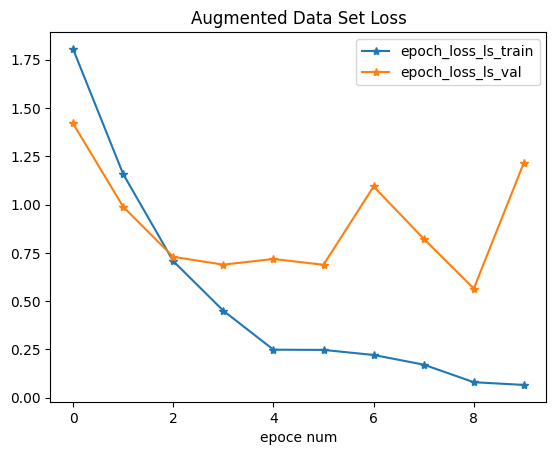

In [75]:
plt.figure()
plt.title("Augmented Data Set Loss")
plt.xlabel("epoce num")
plt.plot(epoch_loss_ls_train,'-*')
plt.plot(epoch_loss_ls_val,'-*')
plt.legend(["epoch_loss_ls_train","epoch_loss_ls_val"])

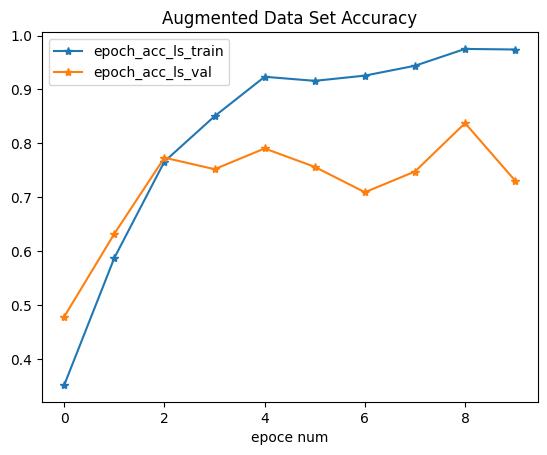

In [76]:
plt.figure()
plt.title("Augmented Data Set Accuracy")
plt.xlabel("epoce num")
plt.plot(epoch_acc_ls_train,'-*')
plt.plot(epoch_acc_ls_val,'-*')
plt.legend(["epoch_acc_ls_train","epoch_acc_ls_val"])

In [77]:
# Predict and recive score:
labels_ls, preds_ls = model_predict(model, num_images=16, set='val')
print("accuracy_score for augmented data set")
acc_score_RandomHorizontalFlip = accuracy_score(labels_ls, preds_ls)

accuracy_score for augmented data set


CM for augmented dataset


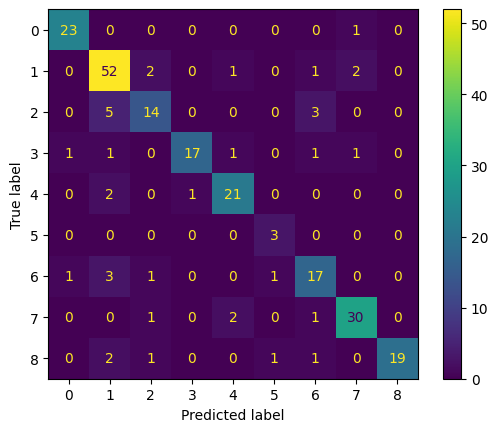

In [78]:
cm_val = confusion_matrix(labels_ls, preds_ls)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_val)
disp.plot()
print("CM for augmented dataset")
plt.show()

### augmented data (RandomRotation)

In [79]:
## first initializing the model so we don't have over-fitting:
# running same code from above to initialize the model
model = models.vgg16(pretrained=True)
model.classifier[6] = nn.Linear(in_features=4096, out_features=9)
model = model.to(device)
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

In [80]:
# augmented data set:
data_transforms_aug = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.RandomRotation([0,20]), # adding this ogmantation method "flip" - guess it is not the best one..
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

In [ ]:
# Training of augmented train data and get accuracy result
# choose the original 9 epochs
# see the loss and accuracy along the epochs so we can compare the the augmented dataset training

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms_aug[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}

model, epoch_acc_ls_val, epoch_acc_ls_train, epoch_loss_ls_val, epoch_loss_ls_train = train_model_NL(model, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                       num_epochs=10)

Epoch 0/9
----------


In [ ]:
plt.figure()
plt.title("Augmented Data Set Loss")
plt.xlabel("epoce num")
plt.plot(epoch_loss_ls_train,'-*')
plt.plot(epoch_loss_ls_val,'-*')
plt.legend(["epoch_loss_ls_train","epoch_loss_ls_val"])

In [ ]:
plt.figure()
plt.title("Augmented Data Set Accuracy")
plt.xlabel("epoce num")
plt.plot(epoch_acc_ls_train,'-*')
plt.plot(epoch_acc_ls_val,'-*')
plt.legend(["epoch_acc_ls_train","epoch_acc_ls_val"])

In [ ]:
# Predict and recive score:
labels_ls, preds_ls = model_predict(model, num_images=16, set='val')
print("accuracy_score for augmented data set")
acc_score_RandomRotation = accuracy_score(labels_ls, preds_ls)

In [ ]:
cm_val = confusion_matrix(labels_ls, preds_ls)
disp = ConfusionMatrixDisplay(confusion_matrix=cm_val)
disp.plot()
print("CM for augmented dataset")
plt.show()

## To Summarize
* when using an augmentation method, it alllows us to enlarge our data set for training, and maybe avoid additional epochs that can lead to overfitting.
* when choosing the augmentation method we should no do so automaticaly, we need to think about our data set, in our case - faces/people. so up-side down roation is not very informative. for example a tilt of 15-30 degree can be usefull and consider people "tilting" their heads.
also augmentation of zoom-in/center crop might also be beneficial for the model training.

* summary of our results:




we think there is no imporvent since we saw already that the model might be over fitted (or other issues with the labeling of the training set) that causes lower accuracy:(



In [ ]:
print("acc_score_original", acc_score_original)
print("acc_score_RandomHorizontalFlip", acc_score_RandomHorizontalFlip)
print("acc_score_RandomRotation", acc_score_RandomRotation)


## Task 5: Model Architectures
In the course we'll cover in depth various DL architectures suggested to perform image classification. Among other things, these networks differ in depth (the number of layers), the number of weights (the network power), the composing layers, and more.  
In the figure below, you can see the performance of different network architectures on the ImageNet Image Classification task, and the number of flops (atomic computations) required for them. 

![CNN performance/flops graph](https://miro.medium.com/max/1838/1*n16lj3lSkz2miMc_5cvkrA.jpeg)

In our code above we've used the `VGG` architecture.  
See if you can increase model performance by using alternative architectures from [torchvision.models](https://pytorch.org/vision/0.8/models.html).  
Pay attention to the input dimensions that each network architecture expects.

### ANSWER
to try and increase performanc we will choose the models that are high in the 'y' axis (accuracy axis) in the upper plot.

first i got the results for VG16 and Alexnet, indeed Alexnet was not better than VGG16 as implid in the image above; the resnet model indeed gave higher accuracy:
#### Accuracy Score for VGG16:
0.8418803418803419

#### Accuracy Score for alexnet:
0.7735042735042735

#### Accuracy Score for resnext50_32x4d:
0.8675213675213675


### Accuracy Score for Densnet:

0.782051282051282




### DATA TO USE IN ALL MODELS BELOW:


In [ ]:
# Original data loaders( from above)
# Define transformations that resize the images to 256x256, and normalize them. 
# The means and standard deviations of each channel are the values used for normalization in ImageNet
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}

## SAME PARAMS FOR ALL MODELS:

In [ ]:
criterion = nn.CrossEntropyLoss()
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)
num_epochs = 10

### First look at our base line (VGG16) model accuracy result:

In [ ]:
# first initializing the model so we don't get the following error:
# running same code from above to initialize the model
model = models.vgg16(pretrained=True)
model.classifier[6] = nn.Linear(in_features=4096, out_features=9)


In [ ]:
model = model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)
num_epochs = 10

In [ ]:
# train
model, epoch_loss_ls, epoch_acc_ls = train_model(model, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                    num_epochs=num_epochs)

In [ ]:
# PREDICT
labels_ls, preds_ls = model_predict(model, num_images=16, set='val')

# SCORE
print("Accuracy Score for VGG16:")
accuracy_score(labels_ls, preds_ls)

### First model chosen: resnext50_32x4d

In [ ]:
resnext50_32x4d = models.resnext50_32x4d(pretrained=True) # dowloading pre-trained model


In [ ]:
# resnext50_32x4d

In [ ]:
#summary(resnext50_32x4d.to(device), (3, 256, 256))

In [ ]:
# This code should output the number of input neurons to the final layer. We'll use it to create a new layer instead of it.
last_layer = list(resnext50_32x4d.children())[-1]
if hasattr(last_layer, 'in_features'):
  num_ftrs = last_layer.in_features
else:
  num_ftrs = last_layer[-1].in_features

num_ftrs

In [ ]:
# Here the size of each output sample is set to 2.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
resnext50_32x4d.fc = nn.Linear(in_features=resnext50_32x4d.fc.in_features, out_features=9)

In [ ]:
#summary(resnext50_32x4d.to(device), (3, 256, 256))

In [ ]:
# If a GPU is available, make the model use it
resnext50_32x4d = resnext50_32x4d.to(device)
optimizer_ft = optim.SGD(resnext50_32x4d.parameters(), lr=0.001, momentum=0.9)

In [ ]:
# TRAIN

resnext50_32x4d, epoch_loss_ls, epoch_acc_ls = train_model(resnext50_32x4d, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                    num_epochs=num_epochs)

In [ ]:
# PREDICT
labels_ls, preds_ls = model_predict(resnext50_32x4d, num_images=16, set='val')

# SCORE
print("Accuracy Score for resnext50_32x4d:")
accuracy_score(labels_ls, preds_ls)

### Second model that should give less good results: alexnet



In [ ]:
alexnet = models.alexnet(pretrained=True)


In [ ]:
alexnet.classifier[6] = nn.Linear(in_features=4096, out_features=9)
alexnet = alexnet.to(device)
optimizer_ft = optim.SGD(alexnet.parameters(), lr=0.001, momentum=0.9)

In [ ]:
# TRAIN

alexnet, epoch_loss_ls, epoch_acc_ls = train_model(alexnet, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                    num_epochs=num_epochs)

In [ ]:
# PREDICT
labels_ls, preds_ls = model_predict(alexnet, num_images=16, set='val')

# SCORE
print("Accuracy Score for alexnet:")
accuracy_score(labels_ls, preds_ls)

In [ ]:
resnet18 = models.resnet18(pretrained=True)
resnet18.fc = nn.Linear(in_features=resnet18.fc.in_features, out_features=9)
inception = resnet18.to(device)
optimizer_ft = optim.SGD(resnet18.parameters(), lr=0.001, momentum=0.9)

In [ ]:
# TRAIN

resnet18, epoch_loss_ls, epoch_acc_ls = train_model(resnet18, 
                    dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                    num_epochs=num_epochs)

In [ ]:
# PREDICT
labels_ls, preds_ls = model_predict(resnet18, num_images=16, set='val')

# SCORE
print("Accuracy Score for resnet18:")
accuracy_score(labels_ls, preds_ls)

## (bonus) Task 6: Design your own Neural Network Architecture
Take a stab at building your own NN architecture.  
To allow you to experiment quickly, we'll limit it to 8 layers max, and up to 10 million parameters. Use [this PyTorch guide](https://pytorch.org/tutorials/beginner/blitz/neural_networks_tutorial.html) for reference.  
Train it only on our provided images - we'll present the winner with the best results on the validation set!